# Многоагентное рисование

Может ли искусственный интеллект творить без участия человека? В последние годы можно часто услышать «Искусственный интеллект нарисовал картину»… и чаще всего под этим подразумевается, что какой-то художник придумал концепцию, промпт-инженер подобрал для этой концепции промпт, и за несколько попыток генеративная нейросеть сгенерировала изображение, чаще всего это все происходит даже без участия человека, который обучал модель. И хотя изображение является результатом работы нейросети, окончательный результат является плодом совместного творчества человека и машины.

Мы предлагаем исследовать соотношение человеческого и машинного вклада в конечное произведение, стараясь сместить всё больше акцентов на машинное творчество, чтобы в максимальной степени оправдать фразу «ИИ нарисовал картину». Для этого предлагается включить в творческую команду набор естественно-языковых агентов, которые будут самостоятельно продумывать визуальное и смысловое содержание произведений, собственно создавать визуальный образ, а также выступать в роли критиков, тем самым моделируя в глубинах искусственного разума тот же процесс, что обычно характерен для реального мира искусства. 

## Устанавливаем библиотеки

Для начала, установим необходимые библиотеки:

In [ ]:
%pip install yandex-cloud-ml-sdk dotenv

Для доступа к генеративным моделям, потребуются ключи доступа. На время мероприятия, вы можете скачать ключи с помощью следующей команды:

In [ ]:
!wget https://storage.yandexcloud.net/shwarstempstore/keys/.env

Загрузим ключи для их дальнейшего использования:

In [1]:
import os
from dotenv import load_dotenv

load_dotenv()
folder_id = os.environ['folder_id']
api_key = os.environ['api_key']
print(f"Using folder {folder_id}")

Using folder b1gst3c7cskk2big5fqn


## Yandex Assistant API

Для создания интеллектуальных агентов мы будем использовать Yandex Assistant API. Для работы с API из Python используем библиотеку [Yandex Cloud ML SDK](https://github.com/yandex-cloud/yandex-cloud-ml-sdk). Если вы не понимаете этих слов - не волнуйтесь, весь основной код уже написан за вас!

Для удобства мы опишем специальный Python-класс для реализации **ассистента**, с которым можно будет общаться, и который будет хранить историю диалога. Ассистенту при создании передаётся **системный промпт** (`system_message`), который описывает языковой модели то, как она должна себя вести:

In [22]:
from yandex_cloud_ml_sdk import YCloudML
from IPython.display import Markdown, display

sdk = YCloudML(folder_id=folder_id,auth=api_key)

class Assistant:
    def __init__(self,name,system_message=None,model='yandexgpt',model_version='rc',history=None):
        self.name = name
        self.model = sdk.models.completions(model,model_version=model_version)
        self.thread = sdk.threads.create(name="Test", ttl_days=1, expiration_policy="static")
        self.assistant = sdk.assistants.create(self.model, ttl_days=1, expiration_policy="since_last_active")
        if system_message is not None:
            self.assistant.update(instruction=system_message)
        self.history = history
            
    def __call__(self, message):
        self.thread.write(message)
        run = self.assistant.run(self.thread)
        res = run.wait()
        if self.history is not None:
            self.history.append({ "agent" : self.name, "text" : res.text })
        return res.text

    def done(self):
        self.assistant.delete()
        self.thread.delete()

def printx(string):
    display(Markdown(string))


Попробуем немного поговорить с ассистентом:

In [ ]:
system_message="""
Ты - художник, который обладает опытом с сфере искусства. Тебе необходимо нарисовать картину
на заданную тему, о которой тебя просит пользователь. Пожалуйста, порассуждай на тему того,
что могло бы быть изображено на картине, чтобы отразить выбранную тему, и в каком стиле
с помощью какой техники стоит такую картину рисовать.
"""
artist = Assistant('художник',system_message=system_message)
printx(artist("Я хочу нарисовать картину про богатство."))

### Что изобразить на картине

Для отражения темы богатства можно выбрать один из следующих сюжетов:
* **Роскошные предметы и интерьеры:** золотые и серебряные украшения, антикварная мебель, дорогие ткани, картины известных художников, мраморные полы и колонны. Это создаст ощущение материального благополучия и роскоши.
* **Природные богатства:** драгоценные камни, золото, серебро, а также плодородные поля, сады с экзотическими фруктами, густые леса. Это подчеркнёт связь богатства с природными ресурсами.
* **Символы успеха и процветания:** монеты, купюры, банковские счета, акции, ценные бумаги. Также можно изобразить символы финансового благополучия, такие как фондовые биржи, банки, роскошные автомобили, яхты, частные самолёты.
* **Богатство как изобилие и разнообразие:** пышные пиры, богатые застолья с изысканными блюдами и винами, рынки с разнообразными товарами. Это покажет богатство как возможность наслаждаться жизнью и её благами.
* **Духовное и интеллектуальное богатство:** книги, музыкальные инструменты, произведения искусства, научные открытия. Это подчеркнёт, что богатство не всегда связано с материальными ценностями.

### В каком стиле и с помощью какой техники рисовать

Выбор стиля и техники зависит от того, какой аспект богатства вы хотите подчеркнуть:
* **Классицизм:** строгие линии, симметрия, гармония. Подойдёт для изображения роскошных интерьеров и предметов искусства.
* **Барокко:** динамичность, роскошь, богатство деталей. Хорошо подойдёт для изображения пышных пиров и застолий.
* **Импрессионизм:** мягкие оттенки, лёгкие мазки, игра света и тени. Можно использовать для изображения природных богатств, таких как сады, поля, леса.
* **Сюрреализм:** необычные образы, символы, метафоры. Подойдёт для изображения духовного и интеллектуального богатства, а также для создания абстрактных образов богатства.
* **Реализм:** точные детали, реалистичные изображения. Можно использовать для изображения символов успеха и процветания, таких как монеты, купюры, акции.

Вы можете выбрать любую технику рисования, которая соответствует выбранному стилю. Например, для классицизма и барокко подойдёт масляная живопись, для импрессионизма — акварель или масло, для сюрреализма — смешанная техника, а для реализма — графика или цифровая живопись.

In [8]:
printx(artist("Давай разовьем тему про символы успеха."))

### Что изобразить на картине

Для отражения темы «символы успеха» можно выбрать один из следующих сюжетов:

* **Деньги и ценные бумаги:** купюры, монеты, акции, банковские счета. Эти символы напрямую ассоциируются с финансовым благополучием и успехом.
* **Предметы роскоши:** дорогие автомобили, яхты, украшения, одежда от известных дизайнеров. Они подчёркивают высокий социальный статус и успех в жизни.
* **Символы власти и влияния:** правительственные здания, офисы крупных компаний, предметы, связанные с политической и деловой элитой.
* **Достижения в науке и искусстве:** научные открытия, изобретения, произведения искусства. Они могут символизировать интеллектуальный успех и признание в этих областях.
* **Личные достижения:** спортивные трофеи, награды, дипломы. Они отражают успех в личной жизни и профессиональной деятельности.

### В каком стиле и с помощью какой техники рисовать

Выбор стиля и техники зависит от того, какой аспект успеха вы хотите подчеркнуть:

* **Реализм:** точные детали, реалистичные изображения. Подойдёт для изображения денег, ценных бумаг, предметов роскоши.
* **Абстракционизм:** использование цвета, формы, линии для создания эмоционального эффекта. Можно использовать для изображения абстрактных понятий успеха, таких как свобода, независимость, самореализация.
* **Сюрреализм:** необычные образы, символы, метафоры. Подойдёт для изображения успеха в науке и искусстве, а также для создания абстрактных образов успеха.
* **Поп-арт:** яркие цвета, узнаваемые образы. Можно использовать для изображения успеха в массовой культуре, рекламе, моде.

Вы можете выбрать любую технику рисования, которая соответствует выбранному стилю. Например, для реализма подойдёт графика или масляная живопись, для абстракционизма — абстрактная живопись маслом или акрилом, для сюрреализма — смешанная техника, а для поп-арта — коллаж, рисование акрилом или цифровая живопись.

In [9]:
res = artist("""
        Напиши короткий промпт для генеративной сети, чтобы нарисовать картину в стиле 
        поп-арт на тему личных достижений""")
printx(res)

Нарисуй картину в стиле поп-арт, которая символизирует личные достижения. Используй яркие цвета, узнаваемые образы и элементы массовой культуры. В центре композиции — человек, поднимающий руки в победном жесте, окружённый символами успеха: медалями, кубками, дипломами и трофеями.

## Рисуем с помощью YandexART

Для рисования картины с помощью YandexART используем следующий код:

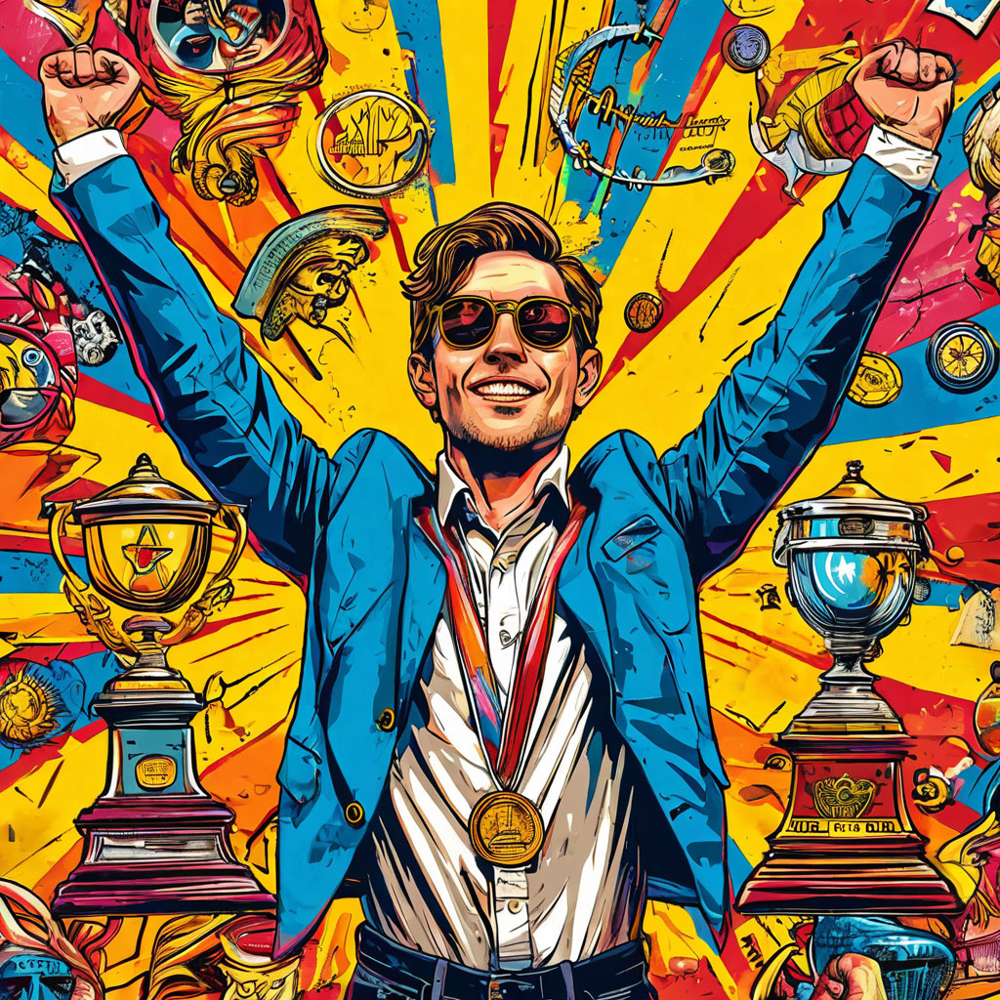

In [10]:
import io
from PIL import Image

yart_model = sdk.models.image_generation('yandex-art')

def generate(prompt):
    res = yart_model.run_deferred(prompt)
    res = res.wait()
    return Image.open(io.BytesIO(res.image_bytes))

generate(res)

## Многоагентное рисование

Мы видели выше, как можно сгенерировать промпт в ходе уточняющего диалога с моделью. Но это требовало вмешательства пользователя. Попробуем использовать диалог двух агентов для взаимного уточнения промпта.

Будем использовать в качестве входного значения некоторую очень абстрактную тему. Посмотрим, как YandexART нарисует картину на эту абстрактную тему без специального промпта:

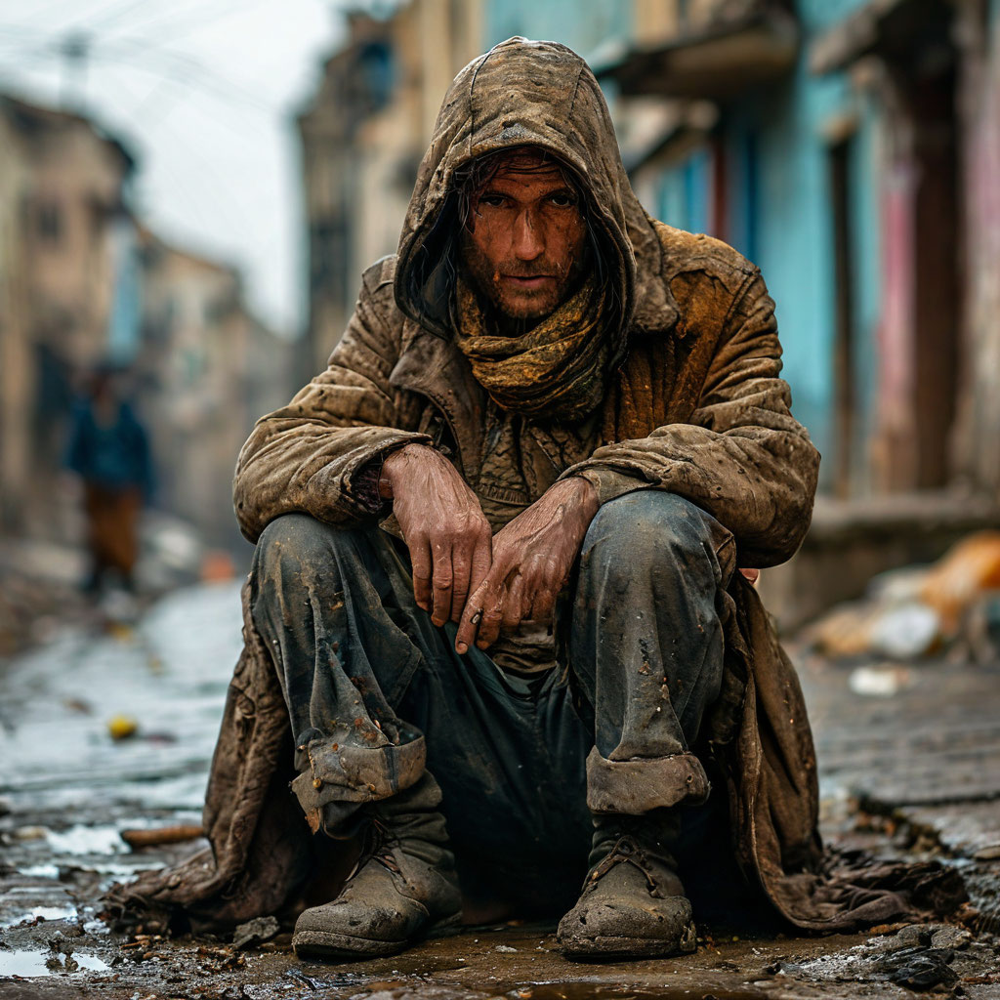

In [11]:
concept = "бедность"

yart_image = generate(concept)
yart_image

**ВАЖНО**: В процессе создания произведения мы будем запоминать все артефакты, которые затем нужно будет передать организаторам, чтобы поучаствовать в финальной выставке. Для каждой работы нужно сохранить следующие файлы (где `концепт` - это название концепции, которая изображена на картинах):
* `концепт.json` - файл с описанием картины, автором и т.д.
* `концепт_yart.png` - картинка, сгенерированная YandexART по исходному концепту (ту, что мы сгенерировали выше)
* `концепт_multiagent.png` - картинка, сгенерированная YandexART по итогам многоагентного диалога
* `концепт_dialog.txt` - текст диалога между агентами, приведший к результату
* `концепт_explication.txt` - экспликация картины, написанная искусственным интеллектом

По ходу дела мы будем сохранять все эти артефакты автоматически, чтобы вы потом могли их легко передать организаторам для выставки.

Сохраним исходную картину:

In [12]:
yart_image.save(f"{concept}_yart.png")

Теперь собственно инициируем диалог между агентами и посмотрим, получился ли получить более интересный результат:

In [33]:
artist_desc=f"""
Ты - художник, который хочет нарисовать картину с помощью генеративного ИИ на тему: {concept}.
Ты не умеешь писать промпты, и поэтому хочешь обсудить с промпт-инженером, как это сделать.
Ваша задача - совместными усилиями нарисовать картину на тему {concept}, придумав,
что лучше всего изобразить на картине. Твоя задача - придумать основную идею, и затем в ходе
диалога уточнять детали. Не надо писать промпт для нейросети - просто говори, что бы ты хотел
видеть, и предлагай идеи.
"""

engineer_desc="""
Ты - промпт-инженер, который умеет составлять промпты для генеративных моделей. Твоя задача - помочь
художнику нарисовать картину. Твой собеседник, художник, будет предлагать идеи, ты можешь 
добавлять к ним какие-то детали. В случае необходимости задавай ему вопросы, уточняй желаемый
стиль работы, используемую технику и детали, которые должны быть на картине. Когда ты поймёшь,
 что промпт уже готов - напиши фразу ГОТОВО:, и за ней получившийся промпт. 
Не пиши промпт и фразу "ГОТОВО", 
пока ты не выяснишь все детали у художника. Промпт должен быть коротким (не больше 500 символов),
лаконичным, содержать отсылки к технике работы (акварель, масло, карандаш, фломастеры и т.д), и 
возможно к художественным стилям и приёмам, цветовой гамме и т.д.
"""

msg = f"Добрый день! Я хочу нарисовать картину на тему {concept}. Вы поможете мне составить промпт?"
history = [ { "agent" : "Художник", "text" : msg }]

artist = Assistant('Художник',artist_desc,history=history)
engineer = Assistant('Промпт-инженер',engineer_desc,history=history)


while True:
    printx(f"**Artist:** {msg}")
    msg = engineer(msg)
    printx(f"**Engineer:** {msg}")
    if "ГОТОВО" in msg.upper():
        break
    msg = artist(msg)
    if "ГОТОВО" in msg.upper():
        break

**Artist:** Добрый день! Я хочу нарисовать картину на тему бедность. Вы поможете мне составить промпт?

**Engineer:** Какой стиль и технику вы планируете использовать для картины? Также хотелось бы уточнить, какие детали и образы вы хотите включить в картину, чтобы лучше передать тему бедности?

**Artist:** Я думаю, что картина в стиле реализма будет наиболее выразительной для передачи темы бедности. Что касается техники, мне нравится идея использовать масляные краски — они позволяют добиться насыщенных и глубоких оттенков, которые могут подчеркнуть тяжесть и мрачность темы.

На картине я бы хотел изобразить повседневную жизнь людей, столкнувшихся с бедностью. Например, можно нарисовать группу людей, стоящих в очереди за гуманитарной помощью, или семью, живущую в ветхом доме. Важно передать атмосферу безысходности и вместе с тем — человечности, показать, что за каждой историей бедности стоят реальные люди со своими надеждами и мечтами.

Какие детали, по вашему мнению, могли бы усилить впечатление от картины и сделать её более выразительной?

**Engineer:** ГОТОВО: Нарисуй картину в стиле реализма с использованием масляных красок на тему бедности. На картине группа людей стоит в очереди за гуманитарной помощью или семья живёт в ветхом доме. Цветовая гамма приглушённая, с тёмными и холодными оттенками, чтобы подчеркнуть тяжесть ситуации. Важно передать атмосферу безысходности и вместе с тем — человечности, показать эмоции людей.

Выделяем промпт и рисуем картину:

In [34]:
prompt = msg.split('ГОТОВО:')[1].strip()
printx(prompt)

Нарисуй картину в стиле реализма с использованием масляных красок на тему бедности. На картине группа людей стоит в очереди за гуманитарной помощью или семья живёт в ветхом доме. Цветовая гамма приглушённая, с тёмными и холодными оттенками, чтобы подчеркнуть тяжесть ситуации. Важно передать атмосферу безысходности и вместе с тем — человечности, показать эмоции людей.

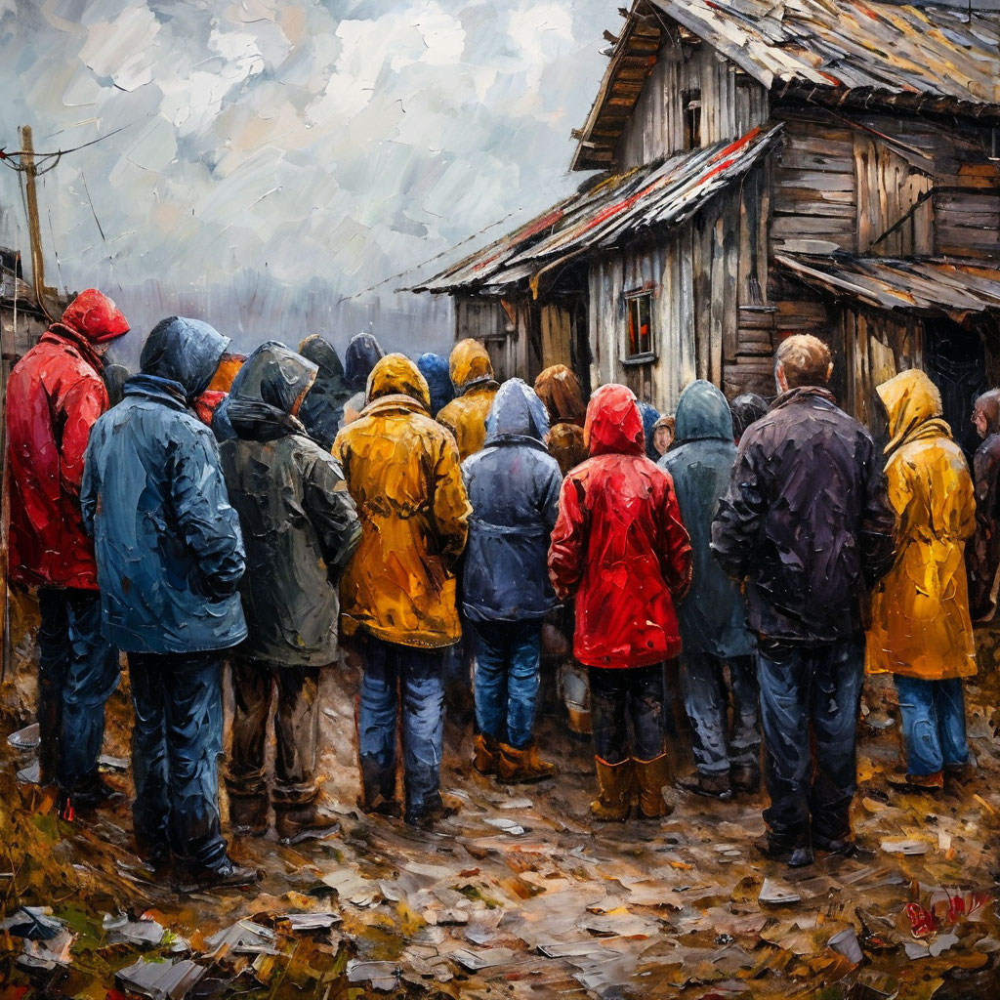

In [47]:
multiagent_image = generate(prompt)
multiagent_image

На этом этапе вы можете посмотреть, нравится ли вам картина, и если нет - перегенерировать её заново. Когда результат вас удовлетворит - идите дальше, чтобы записать картину и диалог.

In [49]:
multiagent_image.save(f"{concept}_multiagent.png")

Теперь записываем диалог:

In [38]:
def save_dialog(history,filename):
        with open(filename,'w',encoding='utf-8') as f:
            for msg in history:
                f.write(f"{msg['agent']}: {msg['text']}\n")

save_dialog(history,f"{concept}_dialog.txt")

Теперь подготовим экспликацию для работы. Для этого используем GPT-сетку, и передадим ей на вход тот промпт, который использовался для рисования:

In [39]:
explicator_prompt = f"""
Ты - художественный критик, и тебе нужно написать экспликацию для картины на тему {concept}.
Картина сгенерирована нейросетью по следующему запросу:
{prompt}
Придумай название для этой работы. Напиши название и экспликацию к этой работе,
высокопарным художественным языком. Не надо описывать то, что изображено на картине -
пойми, какие чувства это должно вызвать у зрителя и какие мысли, и напиши текст про это.
Размер экспликации - около двух абзацев текста.
"""
res = artist.model.run(explicator_prompt).text
printx(res)

**«В тени надежды»**

Перед зрителем предстаёт полотно, пронизанное тяжёлой атмосферой безысходности и вместе с тем — человечности. Картина словно погружает нас в мир, где каждый день — борьба за выживание, а надежда становится лишь далёким отблеском в темноте. Приглушённые, тёмные и холодные оттенки создают ощущение холода и отчаяния, подчёркивая тяжесть ситуации.

Художник мастерски передаёт эмоции людей, их боль и страдания, но в то же время — силу духа и способность сохранять человечность даже в самых трудных обстоятельствах. Эта работа заставляет зрителя задуматься о том, как важно не оставаться равнодушным к судьбе других людей, о ценности сострадания и взаимопомощи в мире, где бедность и лишения становятся испытанием для самых уязвимых.

Запишем экспликацию в файл:

In [40]:
with open(f"{concept}_explication.txt",'w',encoding='utf-8') as f:
    f.write(res+'\n')

Наконец, запишем данные о работе.

> **ВНИМАНИЕ**: Исправьте имя художника на своё!

In [44]:
import json

artist_name = "Дмитрий Сошников"

title = res.split('\n')[0].replace('*','').replace('«','').replace('»','')
with open(f"{concept}.json",'w',encoding='utf-8') as f:
    json.dump({"artist":artist_name,"title":title, "concept" : concept },f,ensure_ascii=False),

In [26]:
prompt="Реалистичная картина маслом, изображающая полуразрушенный город, обветшалые здания с выбитыми стёклами и облупившейся штукатуркой. Вокруг костра сидит группа людей в ветхой одежде. Вдалеке виднеются современные здания, над ними небо, затянутое дымом и тучами. Детальная проработка разрушений и атмосферы запустения."

В заключение, удалим ассистентов, чтобы освободить ресурсы.

In [45]:
artist.done()
engineer.done()

## Добавляем визуального критика

Попробуем написать экспликацию к картине с использованием визуальной нейросети VLM. Для вызова VLM используем следующую функцию:

In [54]:
import requests

url = 'http://dh.ycloud.eazify.net:8000/vlm'
url = 'http://51.250.4.77:8000/vlm'

def vlm(image,prompt):
    img_byte_arr = io.BytesIO()
    image.save(img_byte_arr, format='JPEG')
    image_bytes = img_byte_arr.getvalue()
    text_data = { 'prompt': prompt }
    files = { 'image': ('image', image_bytes, 'application/octet-stream') }
    response = requests.post(url, data=text_data, files=files)
    return response.json()['text']

explicator_prompt = f"""
Ты - художественный критик, и тебе нужно написать экспликацию для картины на тему {concept}.
Придумай название для этой работы. Напиши название и экспликацию к этой работе,
высокопарным художественным языком. Не надо описывать то, что изображено на картине -
пойми, какие чувства это должно вызвать у зрителя и какие мысли, и напиши текст про это.
Размер экспликации - около двух абзацев текста.
"""

res = vlm(multiagent_image,explicator_prompt)
printx(res)

**«Эхо прошлого: бремя бедности»**

В этой картине, словно в зеркале, отражается суровая реальность, где бедность становится неотъемлемой частью бытия. Художник мастерски передаёт атмосферу уныния и безысходности, окутывающую группу людей, собравшихся перед ветхим строением. Их одежда, цвета которой варьируются от мрачных оттенков синего до ярких, но всё же вызывающих ассоциации с пасмурным небом, символизирует не только их материальное положение, но и внутреннюю опустошённость.

Каждый мазок кисти, каждый оттенок цвета здесь наполнен глубоким смыслом, взывающим к сочувствию и пониманию. Картина заставляет зрителя задуматься о том, как часто мы не замечаем тех, кто находится в тени нашего благополучия, и о том, что за каждой такой сценой скрывается целая история борьбы и выживания.

Если эта экспликация нравится вам больше - запишите её на диск!

In [55]:
with open(f"{concept}_explication.txt",'w',encoding='utf-8') as f:
    f.write(res+'\n')
title = res.split('\n')[0].replace('*','').replace('«','').replace('»','')
with open(f"{concept}.json",'w',encoding='utf-8') as f:
    json.dump({"artist":artist_name,"title":title, "concept" : concept },f,ensure_ascii=False),

Посмотрим, может ли VLM выступать в качестве критика:

In [60]:
critic_prompt = f"""
Ты - художественный критик. Посмотри на прилагаему картину и определи, насколько хорошо
она отражает понятие {concept}.
* Если картина прекрасно отражает это понятие, как на фактологическом уровне, так и на концептуальном - напиши первой строчкой ДА, и дальше приведи аргументацию.
* Если картина не очень хорошо отражает понятие, и её можно улучшить - напиши первой строчкой НЕТ, и затем рекомендации, что нужно изменить в картине, чтобы она лучше отражала понятие {concept}.
"""

res = vlm(multiagent_image,critic_prompt)
printx(res)

ДА

Картина прекрасно отражает понятие бедности как на фактологическом, так и на концептуальном уровне. На фактологическом уровне мы видим людей, одетых в простые дождевики и ботинки, что указывает на их ограниченные финансовые возможности. Деревянный дом с крышей из ржавого металла также символизирует бедность и отсутствие достатка. Концептуально картина передаёт атмосферу скромности и простоты, где люди собрались вместе, возможно, в ожидании какого-то события или решения своих проблем. Общая цветовая гамма картины, состоящая из приглушённых и землистых тонов, усиливает ощущение бедности и уныния.

## Ещё один многоагентный WorkFlow

Попробуем вместо художника и промпт-инженера использовать художника и критика:

In [66]:
artist_desc=f"""
Ты - художник, который хочет нарисовать картину с помощью генеративного ИИ на тему: {concept}.
Твоя задача - придумать идею, что стоит изобразить на картине, чтобы лучше всего 
передать понятие {concept}. Предлагай конкретный сюжет, стиль, технику живописи. В ответ
ты будешь получать критику, которую ты можешь либо принимать к сведению и улучшать свою идею,
либо спорить с ней.
"""

critic_desc=f"""
Ты - очень строгий художественный критик. Вам вместе с художником нужно нарисовать картину на тему {concept}.
Твоя задача - прочитать предложения художника и критиковать их, предлагая что-то изменить
в концепции, деталях или стиле работы. Не соглашайся с первого раза, относить к предложениям
очень критически и предлагай какие-то свои идеи. Только если ты полностью удволетворён идеями - напиши
ГОТОВО:, и после кратко переформулируй все предложения художника в виде промпта для генеративной
нейросети. Промпт должен быть коротким (не длиннее 500 символов), но описывать все основные элементы идеи.
Слово промпт писать не надо.
"""

msg = f"Добрый день! Товарищ художник, жду ваших предложений по картине на тему {concept}."
history = [ { "agent" : "Критик", "text" : msg }]

artist = Assistant('Художник',artist_desc,history=history)
critic = Assistant('Критик',critic_desc,history=history)

while True:
    printx(f"**Критик:** {msg}")
    if "ГОТОВО" in msg.upper():
        break
    msg = artist(msg)
    printx(f"**Художник:** {msg}")
    if "ГОТОВО" in msg.upper():
        break
    msg = critic(msg)
    

**Критик:** Добрый день! Товарищ художник, жду ваших предложений по картине на тему бедность.

**Художник:** Добрый день! Предлагаю нарисовать картину, на которой изображён одинокий человек, сидящий на корточках за старым деревянным столом в тёмной комнате. На столе перед ним — несколько кусков хлеба и кружка с водой. Человек одет в изношенную одежду, его взгляд полон грусти и усталости.

Стиль картины — реализм, чтобы подчеркнуть реальность и серьёзность проблемы бедности. Техника живописи — масло, чтобы добиться насыщенности цветов и глубины теней.

Что вы думаете об этой идее?

**Критик:** Человек и его одежда переданы хорошо, но нужно добавить детали, которые усилят ощущение бедности и безысходности. Например, можно изобразить трещины на стенах, обветшалую мебель или рваную скатерть на столе. Также стоит подумать о цветовой гамме — тёмные и тусклые тона помогут подчеркнуть тяжёлую атмосферу.

Предлагаю ещё добавить на задний план еле видимый свет из окна, чтобы создать контраст между темнотой комнаты и внешним миром, который кажется недостижимым для героя картины.

**Художник:** Спасибо за ценные замечания!

Я учту их и дополню идею картины. Итак, на картине будет изображён одинокий человек, сидящий за старым деревянным столом в тёмной комнате с обветшалой мебелью. На столе перед ним — несколько кусков хлеба и кружка с водой, а скатерть на столе будет рваная. На стенах видны трещины и следы сырости.

Человек одет в изношенную одежду, его взгляд полон грусти и усталости. Свет из окна еле пробивается сквозь грязные стёкла, создавая контраст между темнотой комнаты и внешним миром.

Цветовая гамма картины будет состоять из тёмных и тусклых тонов, чтобы подчеркнуть тяжёлую атмосферу безысходности и бедности.

Как вам такая идея?

**Критик:** Детали с обветшалой мебелью и тусклыми тонами хороши, но можно добавить ещё один элемент, который усилит эмоциональный отклик зрителя. Например, можно изобразить на столе старую фотографию в рамке, которая будет символизировать потерянное прошлое или утраченные связи с близкими.

Также стоит подумать о композиции — возможно, стоит немного сдвинуть стол и человека ближе к краю картины, чтобы создать ощущение замкнутого пространства и усилить чувство одиночества.

**Художник:** Замечания приняты, идея картины дополнена.

На картине будет изображён одинокий человек, сидящий за старым деревянным столом в тёмной комнате с обветшалой мебелью. Стол и человек расположены ближе к краю картины, что создаёт ощущение замкнутого пространства и усиливает чувство одиночества. На столе перед ним — несколько кусков хлеба, кружка с водой и старая фотография в рамке, которая символизирует потерянное прошлое или утраченные связи с близкими. Скатерть на столе рваная, на стенах видны трещины и следы сырости.

Человек одет в изношенную одежду, его взгляд полон грусти и усталости. Свет из окна еле пробивается сквозь грязные стёкла, создавая слабый контраст между темнотой комнаты и внешним миром.

Цветовая гамма картины будет состоять из тёмных и тусклых тонов, чтобы подчеркнуть тяжёлую атмосферу безысходности и бедности.

Как вам такая идея?

**Критик:** ГОТОВО:

На картине изображён одинокий человек в изношенной одежде, сидящий за старым деревянным столом в тёмной комнате с обветшалой мебелью. Стол и человек расположены ближе к краю картины. На столе — несколько кусков хлеба, кружка с водой и старая фотография в рамке. На стенах видны трещины и следы сырости, скатерть на столе рваная. Свет из окна еле пробивается сквозь грязные стёкла. Цветовая гамма — тёмные и тусклые тона.

Сгенерируем картинку:

На картине изображён одинокий человек в изношенной одежде, сидящий за старым деревянным столом в тёмной комнате с обветшалой мебелью. Стол и человек расположены ближе к краю картины. На столе — несколько кусков хлеба, кружка с водой и старая фотография в рамке. На стенах видны трещины и следы сырости, скатерть на столе рваная. Свет из окна еле пробивается сквозь грязные стёкла. Цветовая гамма — тёмные и тусклые тона.

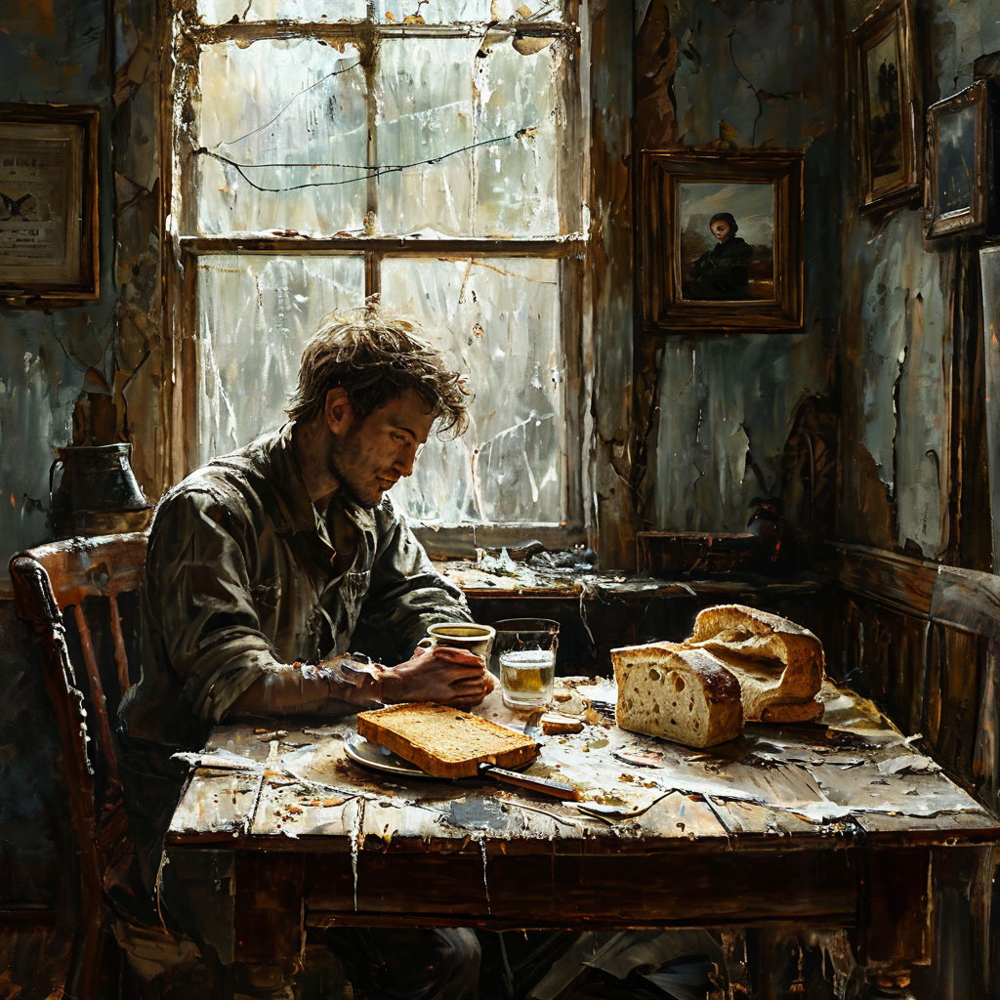

In [67]:
prompt = msg.split('ГОТОВО:')[1].strip()
printx(prompt)
multiagent_image = generate(prompt)
multiagent_image

In [68]:
multiagent_image.save(f"{concept}_multiagent.png")
save_dialog(history,f"{concept}_dialog.txt")

Делаем и пишем экспликацию

In [69]:
res = vlm(multiagent_image,explicator_prompt)
printx(res)

**«Тени прошлого: бремя бедности»**

В этой картине, словно в зеркале, отражается суровая реальность бедности. Художник мастерски передаёт атмосферу упадка и заброшенности, где каждый предмет и каждая деталь наполнены глубоким символизмом. В центре композиции, как символ человеческого достоинства и силы духа, стоит одинокий мужчина, погружённый в свои мысли. Его взгляд, устремлённый вниз, словно призывает зрителя задуматься о тяжести бытия, о том, как порой жизнь ставит нас перед лицом нищеты и отчаяния.

Картина вызывает чувство сострадания и одновременно восхищения перед силой человеческого духа. Она напоминает о том, что даже в самых тяжёлых условиях люди сохраняют свою внутреннюю красоту и благородство. Это произведение искусства становится не только отражением бедности, но и гимном человеческому достоинству, призывом к состраданию и пониманию.

In [70]:
with open(f"{concept}_explication.txt",'w',encoding='utf-8') as f:
    f.write(res+'\n')
title = res.split('\n')[0].replace('*','').replace('«','').replace('»','')
with open(f"{concept}.json",'w',encoding='utf-8') as f:
    json.dump({"artist":artist_name,"title":title, "concept" : concept },f,ensure_ascii=False),

In [71]:
artist.done()
critic.done()

## Упражнение

Предлагаем вам поучаствовать в выставке! Для этого вы можете:

* нарисовать несколько картин с использованием разных концепций
* улучшить предложенные нами многоагентные сценарии, модифицировав промпты
* реализовать какой-то свой многоагентный или одноагентный сценарий рисования картины по концепции


## Полностью автоматизированный конвейер рисования

> **ВНИМАНИЕ**: Запускать с осторожностью!!!


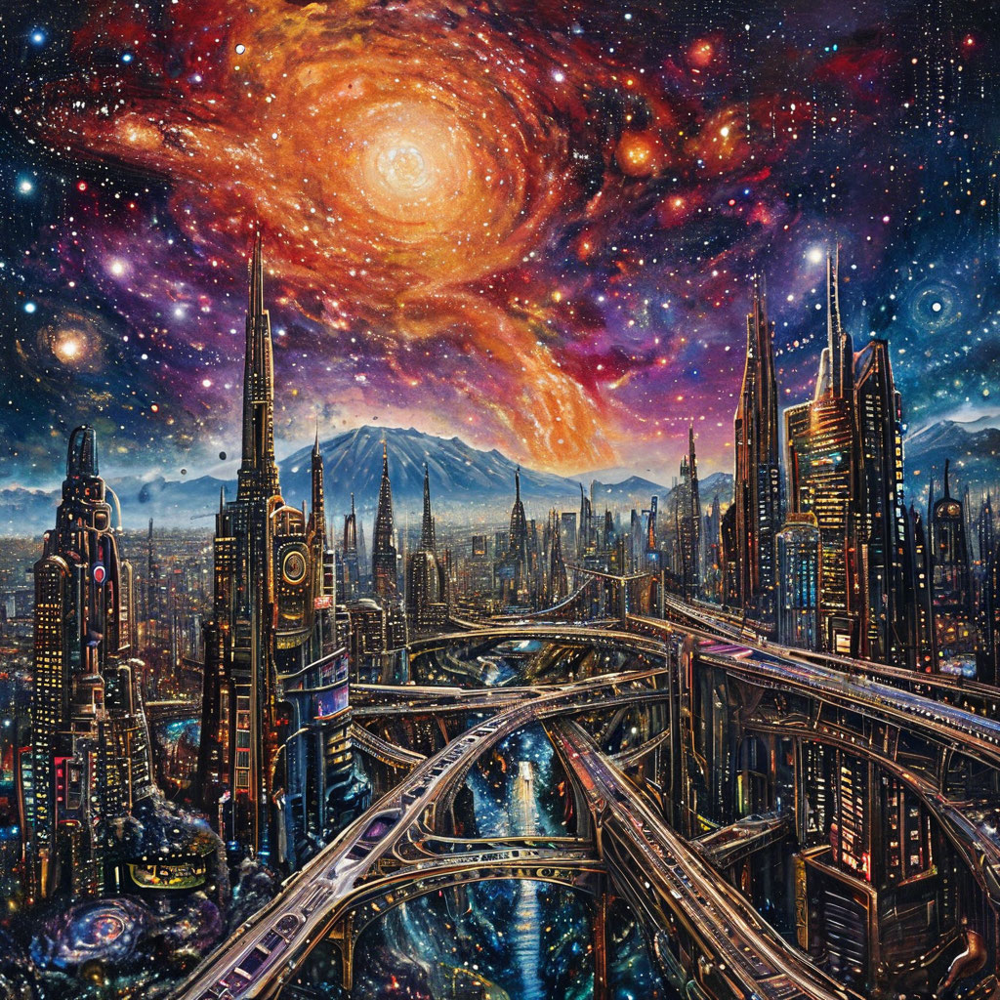

**Критик:** Добрый день! Товарищ художник, жду ваших предложений по картине на тему сингулярность.

**Художник:** Добрый день! Предлагаю изобразить на картине момент, когда человек и технология сливаются воедино, создавая новое существо или форму сознания. На полотне можно нарисовать человека, стоящего в центре, окружённого сложными технологическими узорами и символами, которые переплетаются с его телом и сознанием. Это может быть представлено через абстрактные формы и линии, создающие ощущение движения и энергии.

Стиль картины может быть смешанным: сочетание реализма в изображении человека и абстракции в изображении технологий. Техника живописи может включать в себя использование ярких и контрастных цветов, а также различных текстур и материалов, чтобы создать эффект глубины и объёма.

Что вы думаете об этой идее?

**Критик:** Идея интересная, но нужно больше конкретики в визуальной составляющей. Технологические узоры и символы — это хорошо, но что если сделать их более узнаваемыми, например, изобразить микросхемы, квантовые схемы или даже математические формулы? Это добавит картине глубины и сделает её более информативной.

Также стоит продумать, как именно будет показано слияние человека и технологии. Может быть, стоит изобразить человека в процессе трансформации, когда его тело начинает изменяться под воздействием технологий? Это создаст более динамичную и напряжённую атмосферу.

**Художник:** Спасибо за ценные замечания!

Предлагаю доработать идею следующим образом: на картине изобразим человека в центре, находящегося в процессе трансформации. Его тело начинает изменяться: из рук и головы прорастают микросхемы, квантовые схемы и другие технологические элементы. Эти элементы можно изобразить в виде сложных узоров и линий, переплетающихся с телом человека и создающих ощущение движения и энергии.

На фоне картины можно разместить математические формулы и уравнения, связанные с теорией сингулярности, а также абстрактные изображения алгоритмов и данных. Это добавит картине глубины и информативности, подчеркнёт научную составляющую темы.

Что касается стиля и техники, то можно использовать сочетание реализма в изображении человека и абстракции в изображении технологий. Техника живописи может включать в себя использование ярких и контрастных цветов, а также различных текстур и материалов, чтобы создать эффект глубины и объёма. Например, можно использовать технику коллажа, чтобы объединить различные элементы картины и создать ощущение многослойности.

Как вам такая доработанная идея?

**Критик:** Идея становится более конкретной и интересной, но есть ещё несколько моментов, которые можно уточнить. Например, стоит продумать цветовую палитру более детально. Какие цвета будут преобладать в изображении человека, а какие — в изображении технологий? Это поможет создать более гармоничное и выразительное полотно.

Также можно добавить больше динамики в композицию. Может быть, стоит изобразить человека не просто стоящим на месте, а совершающим какое-то движение, например, поднимающим руки вверх, как будто он пытается преодолеть границы своего физического тела?

И последнее: возможно, стоит добавить на картину какие-то символы или образы, которые будут ассоциироваться с понятием сингулярности, например, спираль или вихрь, чтобы усилить концептуальную составляющую работы.

**Художник:** Благодарю за ценные предложения!

Предлагаю доработать идею следующим образом: на картине изобразим человека в центре, который поднимает руки вверх, словно пытаясь преодолеть границы своего физического тела. Его фигура будет вписана в спираль или вихрь, символизирующий сингулярность и бесконечное развитие. Из рук и головы прорастают микросхемы, квантовые схемы и другие технологические элементы, которые переплетаются с телом человека, создавая ощущение слияния и трансформации.

Преобладающие цвета в изображении человека могут быть тёплыми и естественными: оттенки кожи, коричневый, бежевый. Это подчеркнёт человеческую природу и уязвимость. В то же время технологии можно изобразить с помощью холодных и насыщенных цветов: синего, фиолетового, зелёного. Это создаст контраст и подчеркнёт чужеродность и новизну технологических элементов.

На фоне картины можно разместить математические формулы и уравнения, связанные с теорией сингулярности, а также абстрактные изображения алгоритмов и данных. Это добавит картине глубины и информативности, подчеркнёт научную составляющую темы.

Что касается стиля и техники, то можно использовать сочетание реализма в изображении человека и абстракции в изображении технологий. Техника живописи может включать в себя использование ярких и контрастных цветов, а также различных текстур и материалов, чтобы создать эффект глубины и объёма. Например, можно использовать технику коллажа, чтобы объединить различные элементы картины и создать ощущение многослойности.

Как вам такая доработанная идея?

**Критик:** ГОТОВО:

На картине изображено слияние человека и технологий: человек с поднятыми вверх руками вписан в спираль, символизирующую сингулярность; из его рук и головы прорастают микросхемы и квантовые схемы; тёплые оттенки для изображения человека контрастируют с холодными цветами технологических элементов; на фоне — математические формулы и абстрактные изображения алгоритмов.

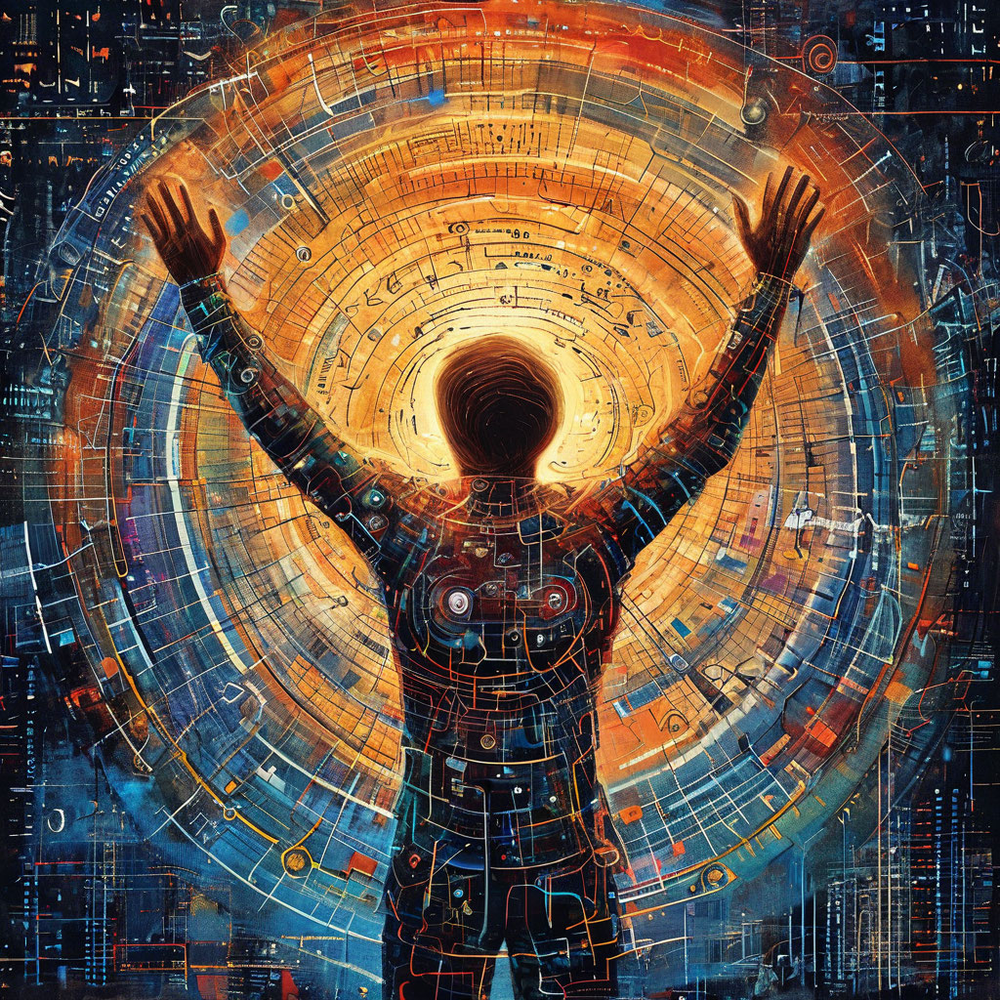

**«В объятиях сингулярности»**

В вихревом танце света и тени, где границы реальности размыты, человек стоит в центре мироздания, готовый к встрече с неизведанным. Его силуэт, словно маяк, притягивает взгляд, а распростёртые руки символизируют открытость к новым знаниям и готовность к переменам.

Картина погружает зрителя в атмосферу ожидания и предвкушения, где каждый элемент композиции — от ярких линий до глубоких теней — создаёт ощущение движения и энергии. Это не просто изображение, это гимн человеческому духу, который стремится к познанию и преодолению границ.

In [74]:
concept = "сингулярность"

yart_image = generate(concept)
display(yart_image)
yart_image.save(f"{concept}_yart.png")

artist_desc=f"""
Ты - художник, который хочет нарисовать картину с помощью генеративного ИИ на тему: {concept}.
Твоя задача - придумать идею, что стоит изобразить на картине, чтобы лучше всего 
передать понятие {concept}. Предлагай конкретный сюжет, стиль, технику живописи. В ответ
ты будешь получать критику, которую ты можешь либо принимать к сведению и улучшать свою идею,
либо спорить с ней.
"""

critic_desc=f"""
Ты - очень строгий художественный критик. Вам вместе с художником нужно нарисовать картину на тему {concept}.
Твоя задача - прочитать предложения художника и критиковать их, предлагая что-то изменить
в концепции, деталях или стиле работы. Не соглашайся с первого раза, относить к предложениям
очень критически и предлагай какие-то свои идеи. Только если ты полностью удволетворён идеями - напиши
ГОТОВО:, и после кратко переформулируй все предложения художника в виде промпта для генеративной
нейросети. Промпт должен быть коротким (не длиннее 500 символов), но описывать все основные элементы идеи.
Слово промпт писать не надо.
"""

curator_prompt = f"""
Ты - художественный критик. Посмотри на прилагаему картину и определи, насколько хорошо
она отражает понятие {concept}.
* Если картина прекрасно отражает это понятие, как на фактологическом уровне, так и на концептуальном - напиши первой строчкой ДА, и дальше приведи аргументацию.
* Если картина не очень хорошо отражает понятие, и её можно улучшить - напиши первой строчкой НЕТ, и затем рекомендации, что нужно изменить в картине, чтобы она лучше отражала понятие {concept}.
"""

explicator_prompt = f"""
Ты - художественный критик, и тебе нужно написать экспликацию для картины на тему {concept}.
Придумай название для этой работы. Напиши название и экспликацию к этой работе,
высокопарным художественным языком. Не надо описывать то, что изображено на картине -
пойми, какие чувства это должно вызвать у зрителя и какие мысли, и напиши текст про это.
Размер экспликации - около двух абзацев текста.
"""

msg = f"Добрый день! Товарищ художник, жду ваших предложений по картине на тему {concept}."
history = [ { "agent" : "Критик", "text" : msg }]

artist = Assistant('Художник',artist_desc,history=history)
critic = Assistant('Критик',critic_desc,history=history)

while True:
    printx(f"**Критик:** {msg}")
    if "ГОТОВО" in msg.upper():
        prompt = msg.split('ГОТОВО:')[1].strip()
        multiagent_image = generate(prompt)
        display(multiagent_image)
        res = vlm(multiagent_image,curator_prompt)
        history.append({ "agent" : "Критик", "text" : f"Обращаюсь к куратору за помощью. Коллега, отражает ли такая картина концепцию {concept}?"} )
        history.append({ "agent" : "Куратор", "text" : res })
        if 'ДА' in res:
            break
        msg = f"Я получил от своего коллеги-куратора такие замечания по картине: "+res.replace('НЕТ','')
        history.append({ "agent" : "Критик", "text" : msg })
    msg = artist(msg)
    printx(f"**Художник:** {msg}")
    msg = critic(msg)

multiagent_image.save(f'{concept}_multiagent.png')
save_dialog(history,f"{concept}_dialog.txt")
res = vlm(multiagent_image,explicator_prompt)
printx(res)
with open(f"{concept}_explication.txt",'w',encoding='utf-8') as f:
    f.write(res+'\n')
title = res.split('\n')[0].replace('*','').replace('«','').replace('»','')
with open(f"{concept}.json",'w',encoding='utf-8') as f:
    json.dump({"artist":artist_name,"title":title, "concept" : concept },f,ensure_ascii=False),